### Neural style transfer in PyTorch

This tutorial implements the "slow" neural style transfer based on the VGG19 model.

It closely follows the official neural style tutorial you can find [here](http://pytorch.org/tutorials/advanced/neural_style_tutorial.html).

__Note:__ if you didn't sit through the explanation of neural style transfer in the on-campus lecture, you're _strongly recommended_ to follow the link above instead of this notebook.

In [1]:
# If you've logged onto GPU for the first time, run this
#!pip3 install --user http://download.pytorch.org/whl/cu80/torch-0.3.0.post4-cp36-cp36m-linux_x86_64.whl 
#!pip3 install --user torchvision

In [2]:
# this is a gpu setup for yandex GPUs @ ICL school. If you use a different hardware just delete this line
%env CUDA_VISIBLE_DEVICES=3 
#                         ^--- YOUR_LOGIN_INDEX % 4

%env LIBRARY_PATH=/usr/local/cuda/lib64
import sys; sys.path.append("/home/user28/.local/lib/python3.6/site-packages/")

env: CUDA_VISIBLE_DEVICES=3
env: LIBRARY_PATH=/usr/local/cuda/lib64


In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.misc import imread, imresize, imrotate

import torch, torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

# desired size of the output image
imsize = 512   # REDUCE THIS TO 128 IF THE OPTIMIZATION IS TOO SLOW FOR YOU
def image_loader(image_name):
    image = imresize(imread(image_name), [imsize, imsize])
    image = image.transpose([2,0,1]) / image.max()
    image = Variable(dtype(image))
    # fake batch dimension required to fit network's input dimensions
    image = image.unsqueeze(0)
    return image

use_cuda = torch.cuda.is_available()

print("torch", torch.__version__)
if use_cuda:
    print("Using GPU.")
else:
    print("Not using GPU.")
dtype = torch.cuda.FloatTensor if use_cuda else torch.FloatTensor



torch 0.3.0.post4
Using GPU.


### Draw input images

In [5]:
style_img = image_loader("images/wave.jpg").type(dtype)

!wget http://cdn.cnn.com/cnnnext/dam/assets/170809210024-trump-nk.jpg -O images/my_img.jpg
content_img = image_loader("images/my_img.jpg").type(dtype)

assert style_img.size() == content_img.size(), \
    "we need to import style and content images of the same size"

--2018-01-24 18:03:27--  http://cdn.cnn.com/cnnnext/dam/assets/170809210024-trump-nk.jpg
Resolving cdn.cnn.com (cdn.cnn.com)... 23.206.208.125, 2600:1404:27:2a2::3134, 2600:1404:27:29d::3134
Connecting to cdn.cnn.com (cdn.cnn.com)|23.206.208.125|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1230999 (1.2M) [image/jpeg]
Saving to: ‘images/my_img.jpg’

images/my_img.jpg   100%[===================>]   1.17M  --.-KB/s    in 0.06s   

2018-01-24 18:03:27 (20.9 MB/s) - ‘images/my_img.jpg’ saved [1230999/1230999]



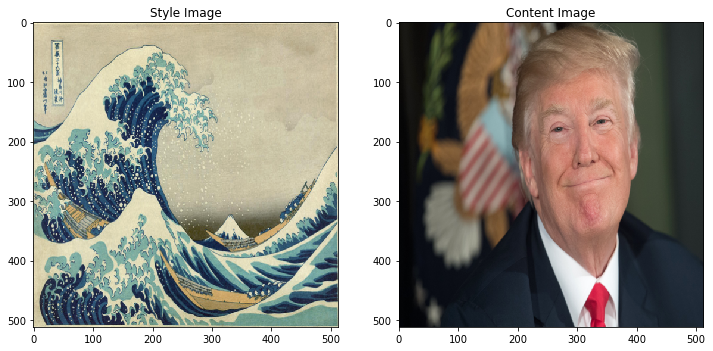

In [6]:
def imshow(tensor, title=None):
    image = tensor.clone().cpu()  # we clone the tensor to not do changes on it
    image = image.view(3, imsize, imsize)  # remove the fake batch dimension
    image = image.numpy().transpose([1,2,0])
    plt.imshow(image / np.max(image))
    if title is not None:
        plt.title(title)

plt.figure(figsize=[12,6])
plt.subplot(1,2,1)
imshow(style_img.data, title='Style Image')
plt.subplot(1,2,2)
imshow(content_img.data, title='Content Image')

### Define Style Transfer Losses

As shown in the lecture, we define two loss functions: content and style losses.

Content loss is simply a pointwise mean squared error of high-level features while style loss is the error between gram matrices of intermediate feature layers.

To obtain the feature representations we use a pre-trained VGG19 network.

In [7]:
import torchvision.models as models

cnn = models.vgg19(pretrained=True).features

# move it to the GPU if possible:
if use_cuda:
    cnn = cnn.cuda()

In [8]:
class ContentLoss(nn.Module):

    def __init__(self, target, weight):
        super(ContentLoss, self).__init__()
        # we 'detach' the target content from the tree used
        self.target = target.detach() * weight
        self.weight = weight

    def forward(self, input):
        self.loss = F.mse_loss(input * self.weight, self.target)
        return input.clone()

    def backward(self, retain_graph=True):
        self.loss.backward(retain_graph=retain_graph)
        return self.loss

In [9]:
def gram_matrix(input):
    a, b, c, d = input.size()  # a=batch size(=1)
    # b=number of feature maps
    # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d)  # resise F_XL into \hat F_XL

    G = torch.mm(features, features.t())  # compute the gram product

    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G.div(a * b * c * d)
    
class StyleLoss(nn.Module):

    def __init__(self, target, weight):
        super(StyleLoss, self).__init__()
        self.target = target.detach() * weight
        self.weight = weight

    def forward(self, input):
        self.G = gram_matrix(input)
        self.G.mul_(self.weight)
        self.loss = F.mse_loss(self.G, self.target)
        return input.clone()

    def backward(self, retain_graph=True):
        self.loss.backward(retain_graph=retain_graph)
        return self.loss

### Style transfer pipeline

We can now define a unified "model" that computes all the losses on the image triplet (content image, style image, optimized image) so that we could optimize them with backprop (over image pixels).

In [10]:
content_weight=1            # coefficient for content loss
style_weight=1000           # coefficient for style loss
content_layers=('conv_4',)  # use these layers for content loss
style_layers=('conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5') # use these layers for style loss


In [11]:
content_losses = []
style_losses = []

model = nn.Sequential()  # the new Sequential module network
# move these modules to the GPU if possible:
if use_cuda:
    model = model.cuda()

i = 1
for layer in list(cnn):
    if isinstance(layer, nn.Conv2d):
        name = "conv_" + str(i)
        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).clone()
            content_loss = ContentLoss(target, content_weight)
            model.add_module("content_loss_" + str(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).clone()
            target_feature_gram = gram_matrix(target_feature)
            style_loss = StyleLoss(target_feature_gram, style_weight)
            model.add_module("style_loss_" + str(i), style_loss)
            style_losses.append(style_loss)

    if isinstance(layer, nn.ReLU):
        name = "relu_" + str(i)
        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).clone()
            content_loss = ContentLoss(target, content_weight)
            model.add_module("content_loss_" + str(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).clone()
            target_feature_gram = gram_matrix(target_feature)
            style_loss = StyleLoss(target_feature_gram, style_weight)
            model.add_module("style_loss_" + str(i), style_loss)
            style_losses.append(style_loss)

        i += 1

    if isinstance(layer, nn.MaxPool2d):
        name = "pool_" + str(i)
        model.add_module(name, layer)  # ***

### Optimization

We can now optimize both style and content loss over input image.

In [12]:
input_image = Variable(content_img.clone().data, requires_grad=True)
optimizer = torch.optim.LBFGS([input_image])

Step # 0 Style Loss : 534.929443 Content Loss: 0.000000


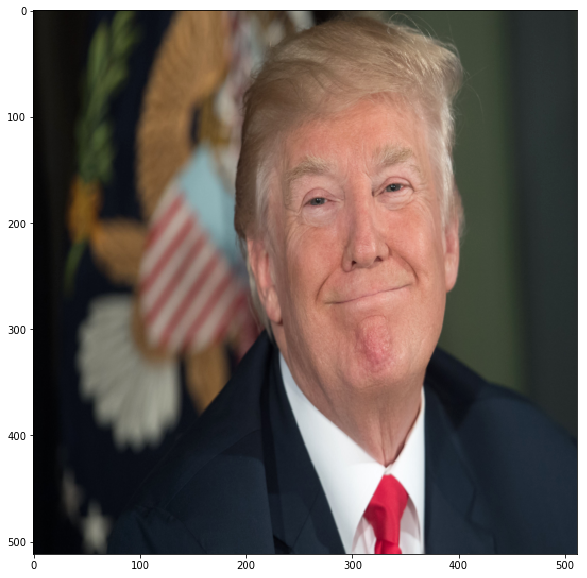

Step # 10 Style Loss : 26.404875 Content Loss: 3.430073


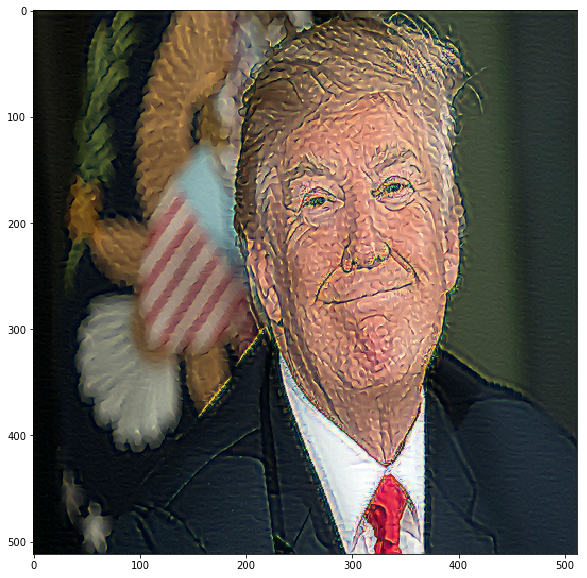

Step # 20 Style Loss : 9.630330 Content Loss: 3.745443


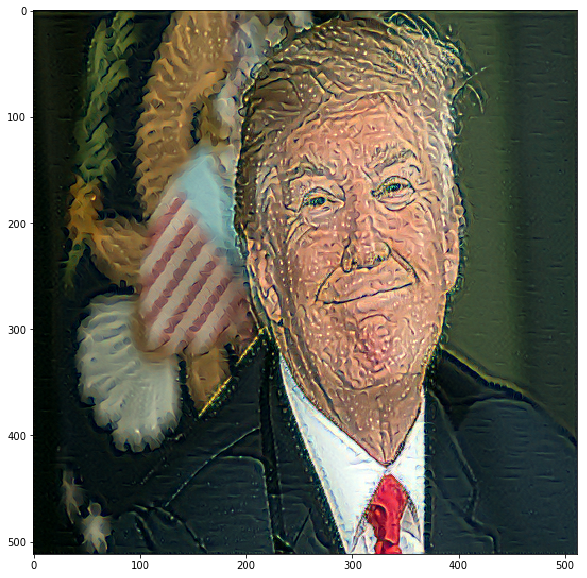

Step # 30 Style Loss : 6.799450 Content Loss: 3.716443


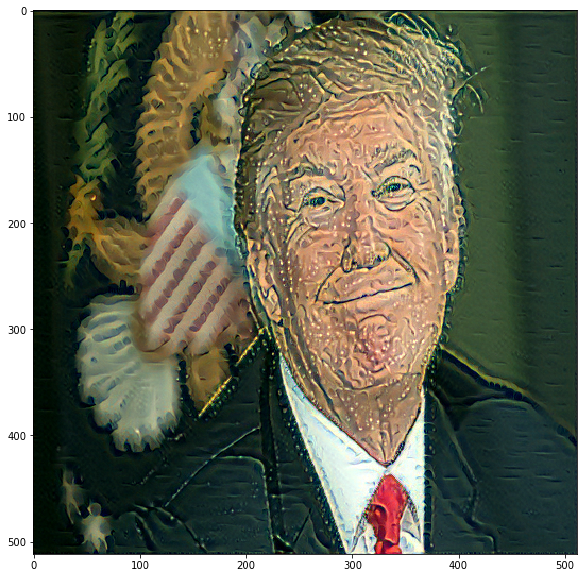

Step # 40 Style Loss : 4.682585 Content Loss: 3.728466


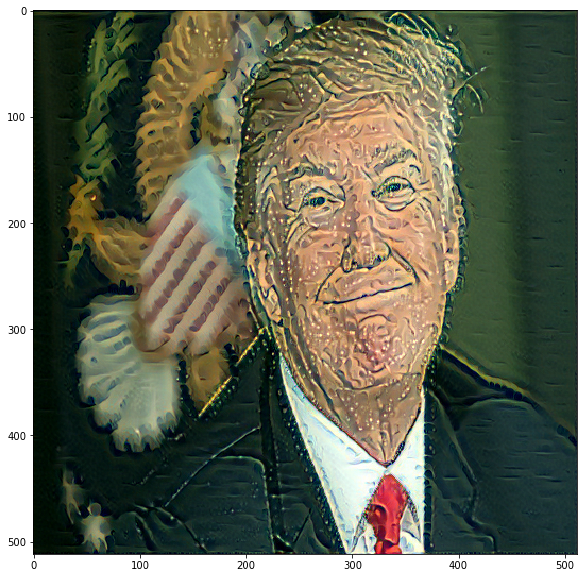

Step # 50 Style Loss : 4.000960 Content Loss: 3.713726


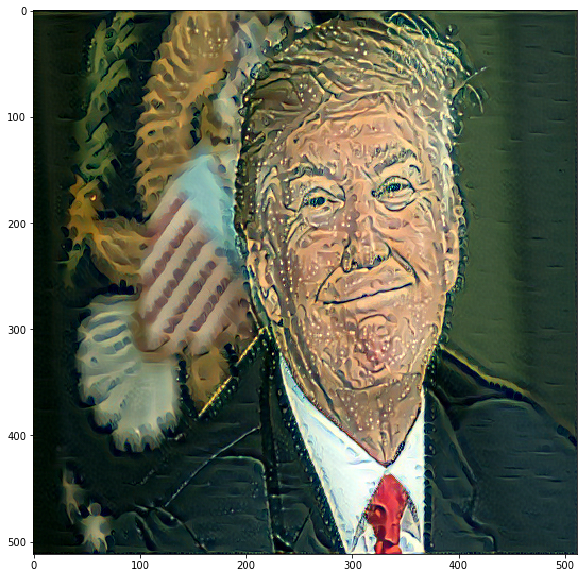

Step # 60 Style Loss : 3.608164 Content Loss: 3.669052


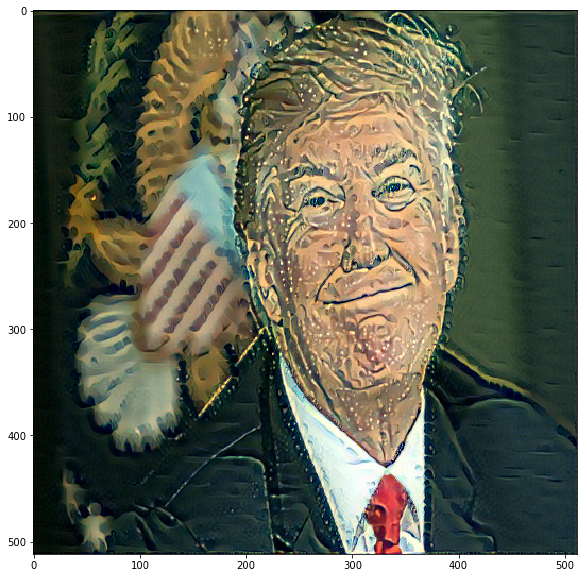

Step # 70 Style Loss : 3.298205 Content Loss: 3.638927


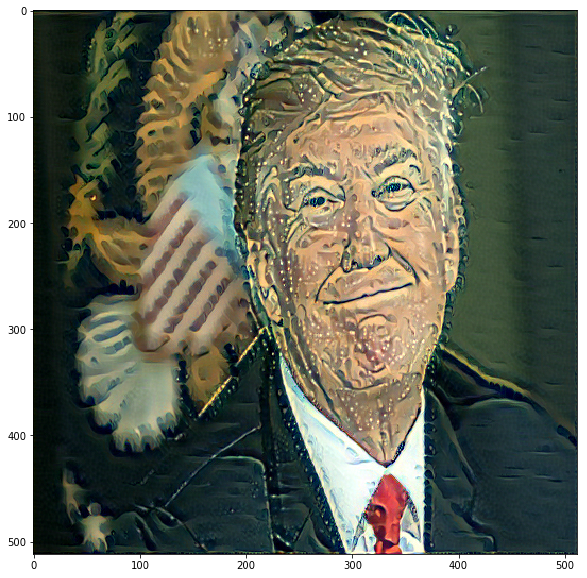

Step # 80 Style Loss : 3.052581 Content Loss: 3.602881


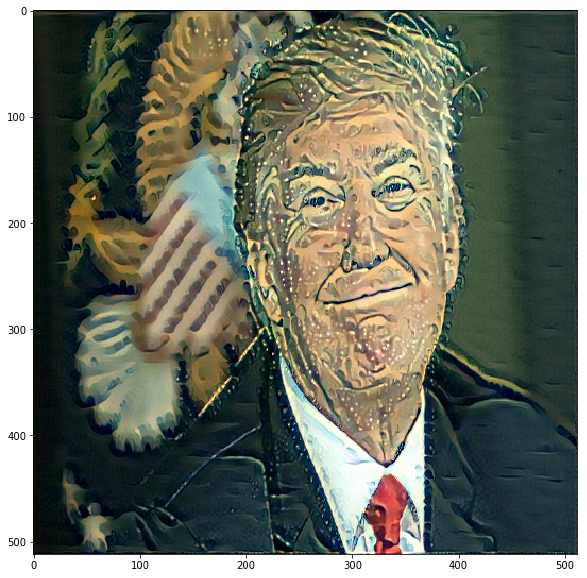

Step # 90 Style Loss : 2.868468 Content Loss: 3.562498


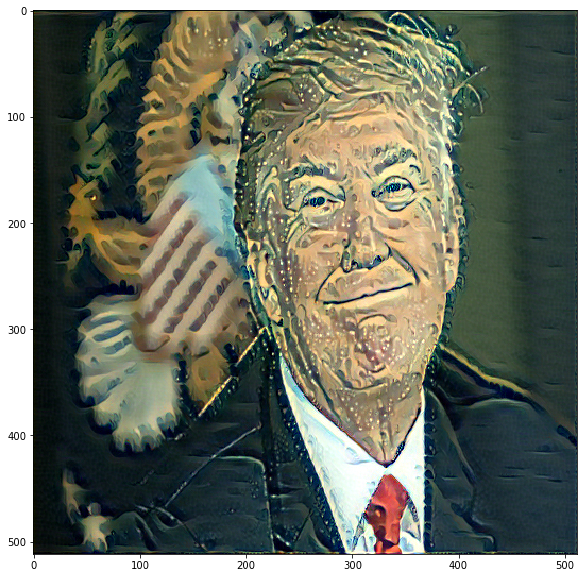

Step # 100 Style Loss : 2.658185 Content Loss: 3.531041


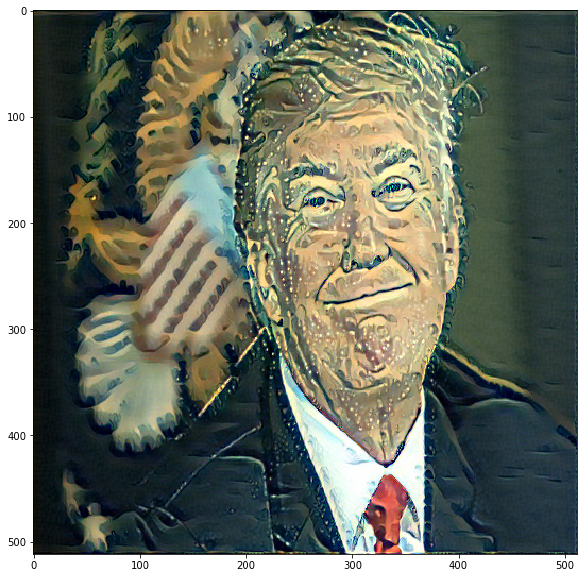

Step # 110 Style Loss : 2.443646 Content Loss: 3.520304


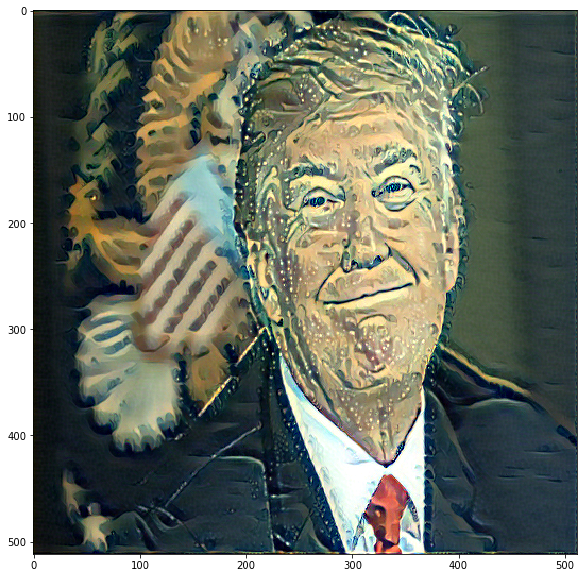

Step # 120 Style Loss : 2.337765 Content Loss: 3.497555


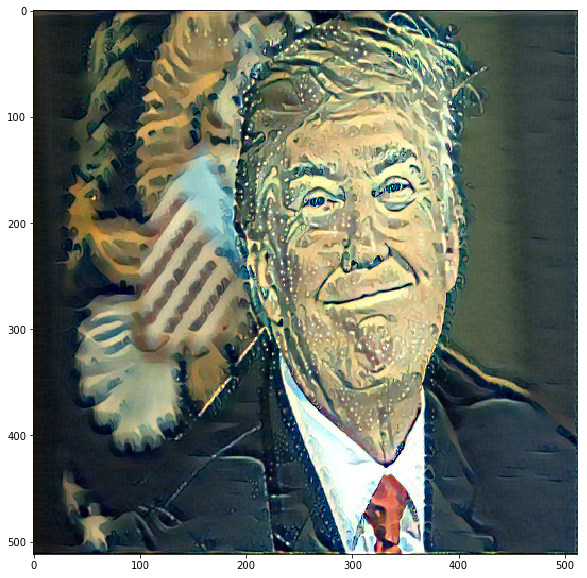

Step # 130 Style Loss : 2.182893 Content Loss: 3.484143


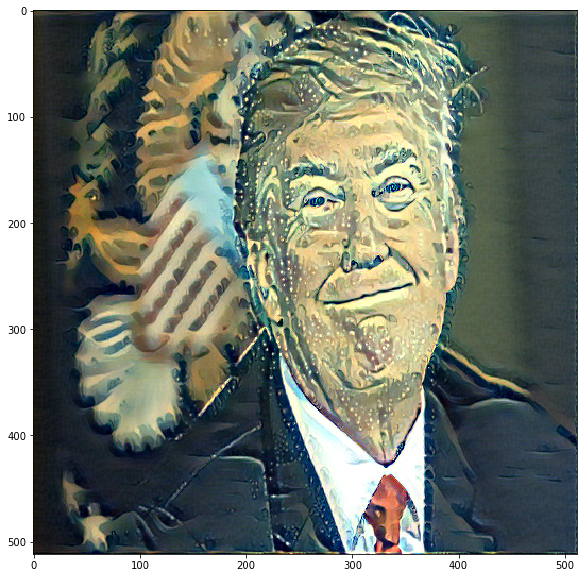

Step # 140 Style Loss : 1.855032 Content Loss: 3.499506


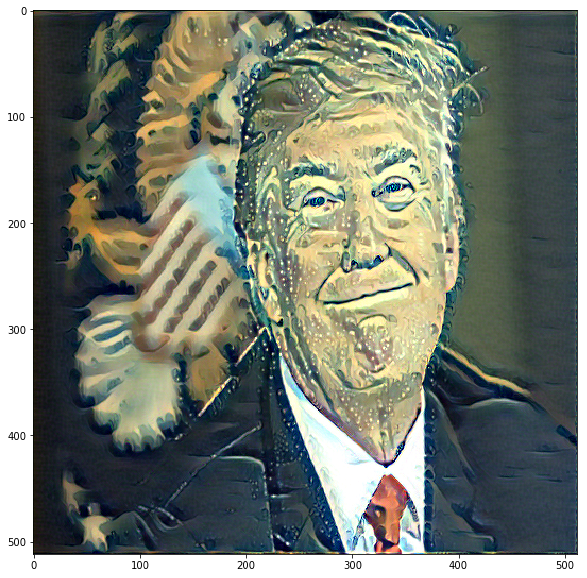

Step # 150 Style Loss : 1.645610 Content Loss: 3.496034


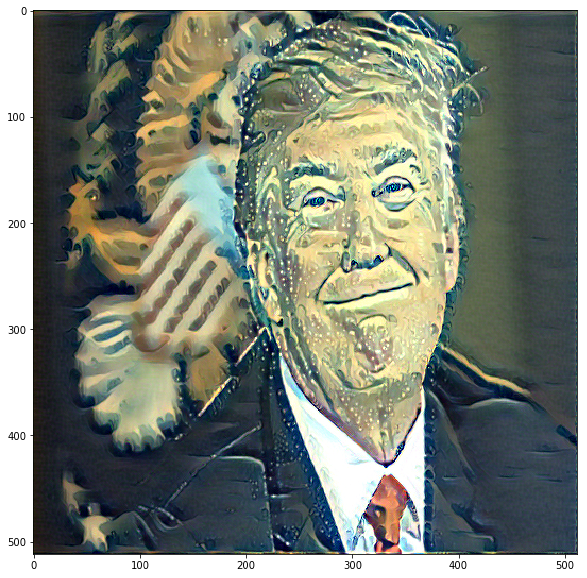

Step # 160 Style Loss : 1.460647 Content Loss: 3.482781


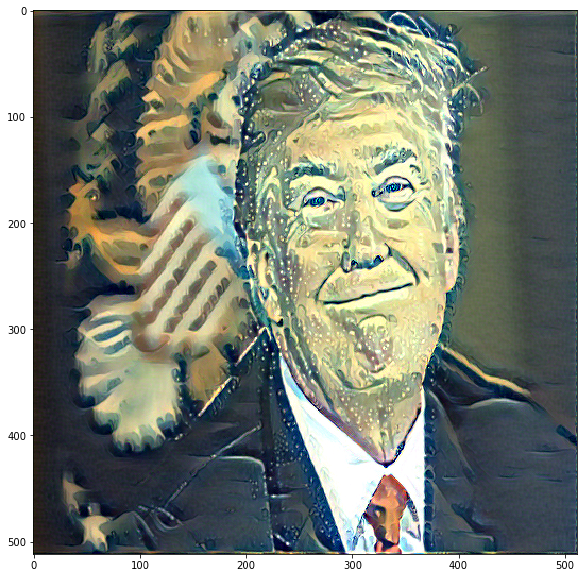

Step # 170 Style Loss : 1.213904 Content Loss: 3.512227


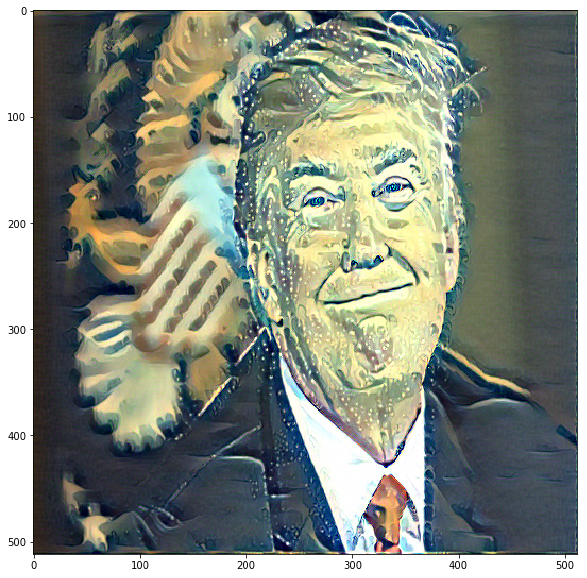

Step # 180 Style Loss : 1.017916 Content Loss: 3.533531


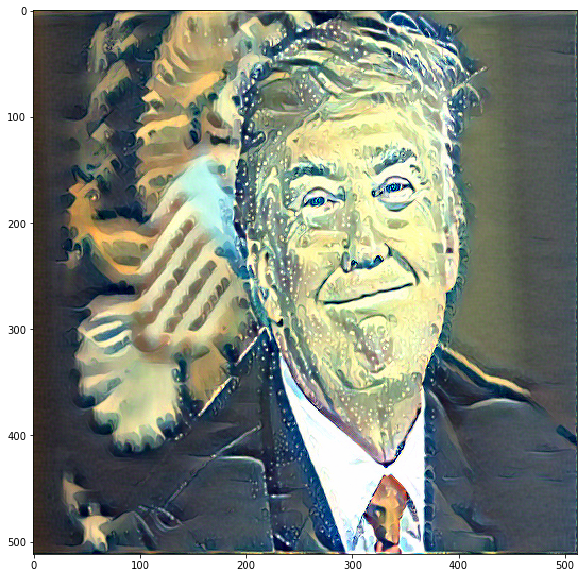

Step # 190 Style Loss : 0.834884 Content Loss: 3.536389


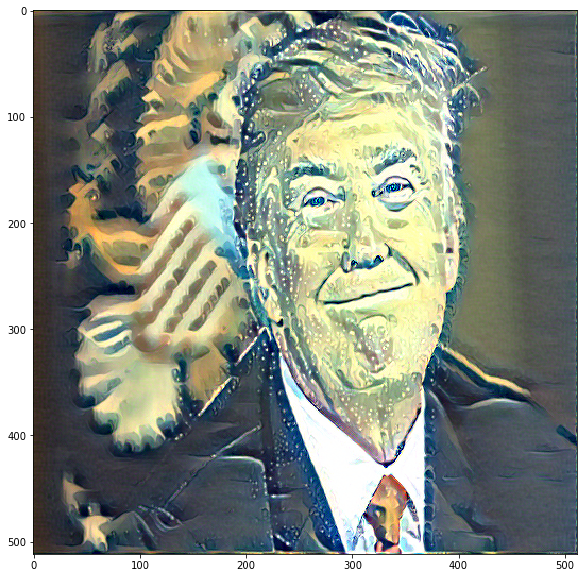

Step # 200 Style Loss : 0.724204 Content Loss: 3.541792


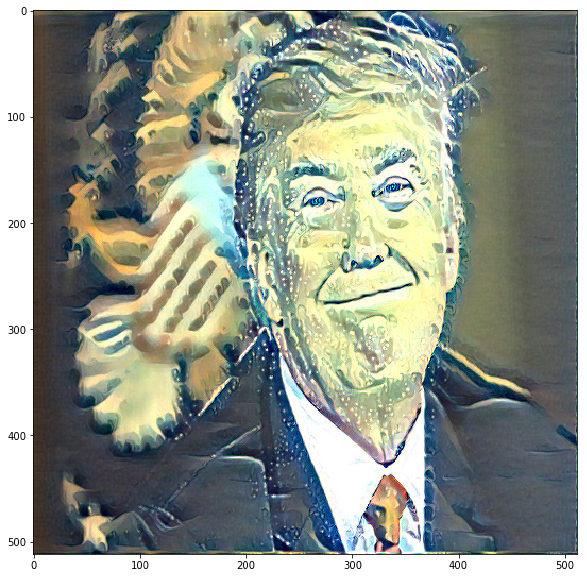

Step # 210 Style Loss : 0.558782 Content Loss: 3.572906


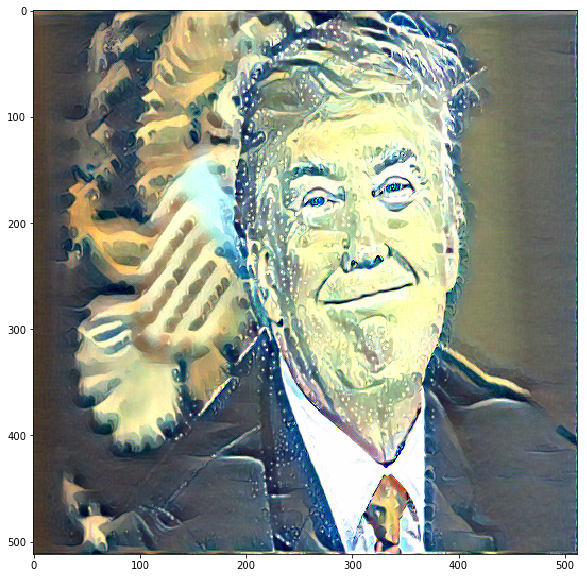

Step # 220 Style Loss : 0.473834 Content Loss: 3.564349


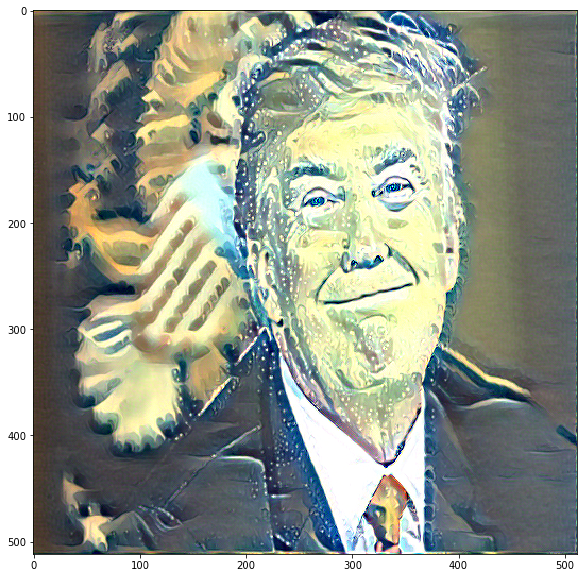

Step # 230 Style Loss : 0.435847 Content Loss: 3.563806


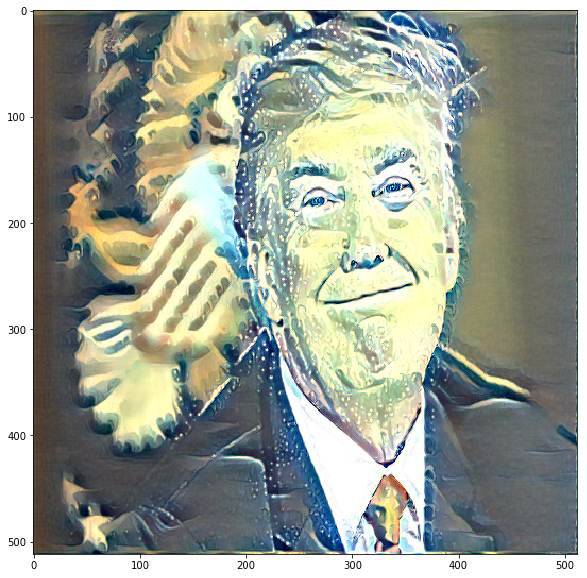

Step # 240 Style Loss : 0.359207 Content Loss: 3.614466


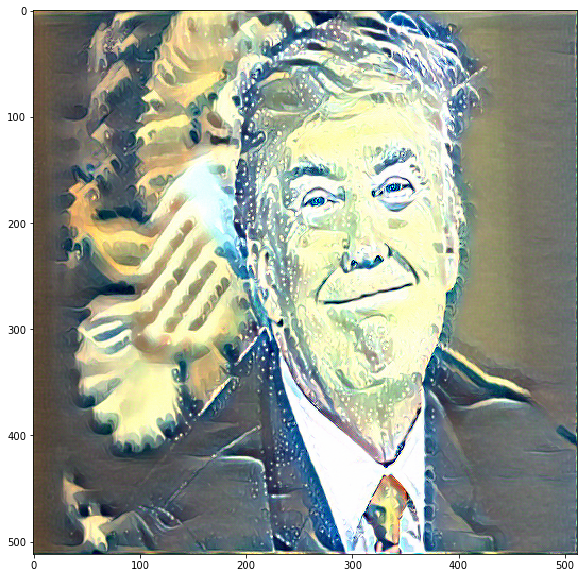

Step # 250 Style Loss : 0.296418 Content Loss: 3.594388


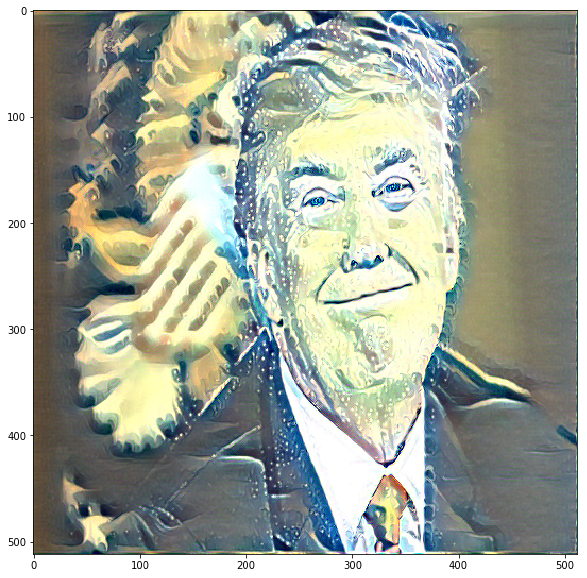

Step # 260 Style Loss : 0.843938 Content Loss: 3.619997


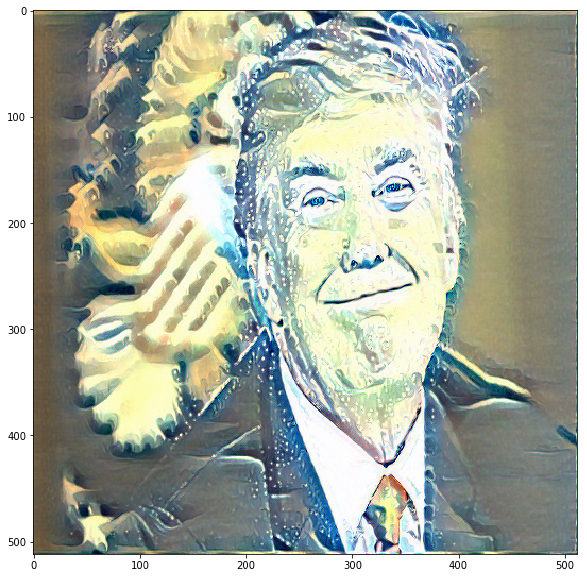

Step # 270 Style Loss : 0.292622 Content Loss: 3.614079


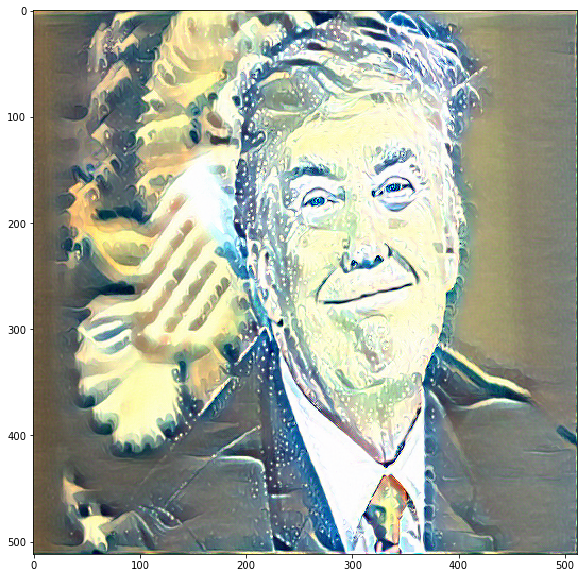

Step # 280 Style Loss : 0.237509 Content Loss: 3.538014


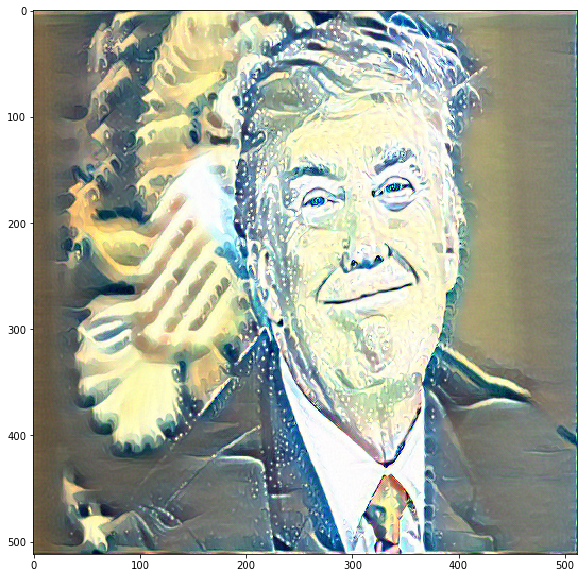

Step # 290 Style Loss : 0.234693 Content Loss: 3.479138


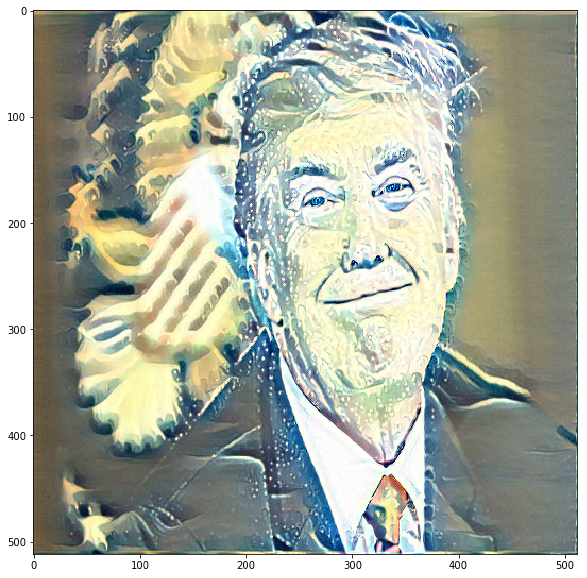


( 0 , 0 ,.,.) = 
  0.3458  0.5538  0.5870  ...   0.5386  0.5147  0.2553
  0.7985  0.8606  0.8874  ...   0.8296  0.8835  0.7605
  0.8884  0.7696  0.7486  ...   0.6990  0.8745  0.6702
           ...             ⋱             ...          
  0.5248  0.5191  0.4749  ...   0.5943  0.6232  0.4316
  0.4326  0.4483  0.4814  ...   0.7264  0.8156  0.5540
  0.2001  0.1898  0.1868  ...   0.2832  0.3700  0.1464

( 0 , 1 ,.,.) = 
  0.6955  0.9332  0.7895  ...   0.7548  0.8165  0.6161
  0.7273  0.7023  0.5748  ...   0.7127  0.6879  0.9068
  0.6348  0.5974  0.5044  ...   0.6916  0.6606  0.8550
           ...             ⋱             ...          
  0.4844  0.4809  0.3931  ...   0.6265  0.6119  0.7340
  0.4394  0.4315  0.3903  ...   0.6038  0.6606  0.6303
  0.3532  0.3730  0.3215  ...   0.4211  0.4676  0.2365

( 0 , 2 ,.,.) = 
  0.2373  0.3696  0.2905  ...   0.4693  0.5022  0.4835
  0.1373  0.3012  0.3451  ...   0.6185  0.3699  0.5641
  0.1776  0.5807  0.6565  ...   0.7242  0.4749  0.5962
           

In [13]:
num_steps = 300

for i in range(num_steps):
    # correct the values of updated input image
    input_image.data.clamp_(0, 1)

    model(input_image)
    style_score = 0
    content_score = 0
    for sl in style_losses:
        style_score += sl.backward()
    for cl in content_losses:
        content_score += cl.backward()
        
    if i % 10 == 0:  # <--- adjust the value to see updates more frequently
        
        print('Step # {} Style Loss : {:4f} Content Loss: {:4f}'.format(
            i, style_score.data[0], content_score.data[0]))
        plt.figure(figsize=[10,10])
        imshow(input_image.data)
        plt.show()
        
    loss = style_score + content_score
    
    optimizer.step(lambda:loss)
    optimizer.zero_grad()
    
# a last correction...
input_image.data.clamp_(0, 1)

### Final image

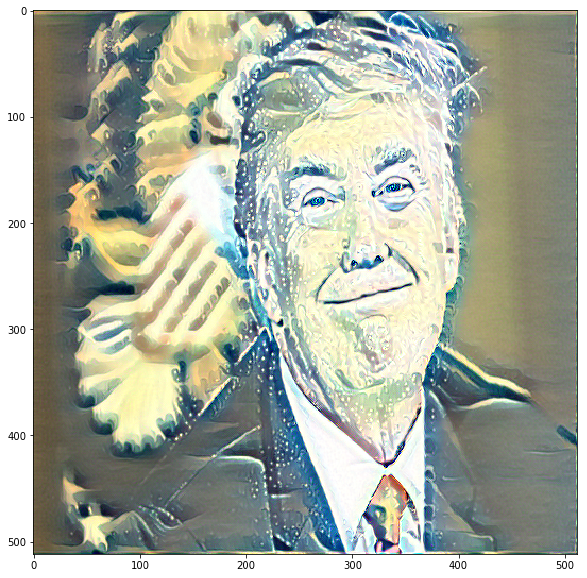

In [14]:
plt.figure(figsize=[10,10])
imshow(input_image.data)
plt.show()